<h1 align="center"></h1>
<h1 align="center">Problem 1 - Building an HBM</h1>
<h2 align="center">Hierarchical Bayesian Modeling of a Truncated Gaussian Population with PyStan and PyJAGS</h2>
<div align="center">Simulating the distribution of "$\boldsymbol{e \cos \omega}$" for hot Jupiter exoplanets from  <i>Kepler</i>. These simulated exoplanet candiates are potentially undergoing migration and orbital circularization. </div> 
<h4 align="center">LSSTC DSFP Session 4, September 21st, 2017</h4>
<h5 align="center">Author: Megan I. Shabram, PhD, 
NASA Postdoctoral Program Fellow,  mshabram@gmail.com</h5>

<div><p>In this Hierachical Bayesian Model workbook, we will first be using <a href="http://mc-stan.org/users/documentation/case-studies.html">Stan</a>, a <a href="https://en.wikipedia.org/wiki/Hybrid_Monte_Carlo">Hamiltonian Monte Carlo method </a>to obtain a sample from the full posterior distribution of a truncated Gaussian population model, where the measurement uncertainty of the population constituent are Normally distributed. The truncation renders this HBM with no analytical solution, thus requiring monte a carlo numerical approximation technique. After we investigate using Stan, we will then explore using <a href="https://martynplummer.wordpress.com/2016/01/11/pyjags/"> JAGS</a> a <a href="https://en.wikipedia.org/wiki/Gibbs_sampling">Gibbs sampling</a> method (that reverts to Metropolis-Hastings when necessary), on the same problem. The simulated data sets generated below are modeled after the projected eccentricity obtained for exoplanet systems that both transit and occult their host star (see Shabram et al. 2016)</p><div>

<h3 align="left"> Goals of this workbook series:</h3>
- Learn how to use a computing infrastructre that allows you to carry out future HBM research projects. 
- Gain a sense for the workflow involved in setting up an HBM, in particular, using key diagnostics, and using simulated data before application to your real dataset.
- Practice data wrangling with pandas data frames and numpy dictionaries. 
- Understand the relationship between data quantity, quality, number of iterations, and analysis model complexity (also refered to as a population model or a space function)
- Learn how to run HBM on datasets with missing values using JAGS.

- Challege problem: model mispecification, (running Nm2 data through Nm1 model)

In [1]:
import numpy as np
import scipy.stats as stats
import pandas as pd
import matplotlib.pyplot as plt
import pyjags
import pystan
import pickle
import triangle_linear

from IPython.display import display, Math, Latex
from __future__ import division, print_function
from pandas.tools.plotting import *
from matplotlib import rcParams
rcParams["savefig.dpi"] = 100
rcParams["font.size"] = 20
#plt.style.use('ggplot')

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
#%qtconsole


//anaconda/lib/python2.7/site-packages/matplotlib/font_manager.py:273: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  warnings.warn('Matplotlib is building the font cache using fc-list. This may take a moment.')


<h3 align="left"> 1. Generate simulated data set from a Single Gaussian generative model</h3>

<div><p>Eccentricity cannot be greater than 1 physically (or it means an unbound orbit and
that is not the case for planet observed to both transit and occult more than once).
This creates a situation where the distributions must be truncated, rendering the 
problem unable to be calculated analytically, and requaring numerical methods such
the MCMC sampler used below, jags, called with pyjags.</p><div>

In [2]:
## function to draw from truncated normal, this function will be used for both the 
## one- and two-componenet cases in this workbook.  

def rnorm_bound( Ndata, mu, prec, lower_bound = 0.0, upper_bound = float('Inf')):
    x = np.zeros(Ndata)
    #print(x)
    for i in range(0, Ndata): 
            #print(i)
            while True:
                x[i] = np.random.normal(mu,prec,1)
                if( (x[i]>lower_bound) and (x[i]<upper_bound) ): 
                    break
    return x;

[-0.23639223 -0.38880867  0.71913359 -0.16023551 -0.15174314 -0.06981613
  0.31952855 -0.24764533  0.77188003 -0.17641282 -0.36829463  0.01590002
  0.3195046   0.00633438  0.11606721 -0.18717468  0.34881203  0.11339988
 -0.2857274   0.05142801 -0.11210611  0.66015684  0.09528037 -0.43380692
 -0.35747181] [-0.2291849  -0.38208134  0.74792455 -0.18371994 -0.14840336 -0.08310707
  0.37267708 -0.22708107  0.73541073 -0.18352301 -0.42884625 -0.00295714
  0.26468923 -0.00204485  0.11946989 -0.16209109  0.30286965  0.15896095
 -0.26129722  0.00549672 -0.13009823  0.64488943  0.13783177 -0.43582619
 -0.40136044]


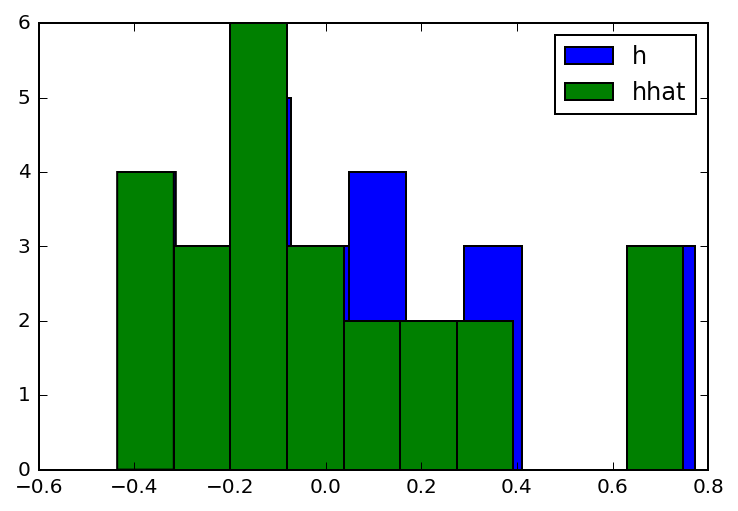

In [3]:
## One-component Gaussian Mixture Simulated Data
## Below we designate the population values of our generative model. These are the 
## truths that we should recover if our hiararchical Bayesian model is properly specified 
## and diagnostics have indicated that the simulation has "not not converged". "You can't 
## prove convergence, at best you can fail to prove a failure to converge".

## In this simulated data set, their are 50 planetary systems (with one planet each)
Ndata = 25 
## Here we asign the dispersion of the simulated population to be 0.3, this is 
## the truth we wish to recovern 
sigmae = 0.3 
## We approximate the uncertainty for each measurement as normally distributed about a 
## reporte measurement point estimate.  For the eccentricity distribution for Hot Jupiter
## the physical models used to derive these produce larger uncertainty in k by a factor of 2. 
sigmahobs = 0.04

h = np.repeat(0.,Ndata)
hhat = np.repeat(0.,Ndata)
hhat_sigma  = np.repeat(sigmahobs,Ndata)

#print(khat_sigma)


for i in range(0,Ndata):
    h[i] = rnorm_bound(1,0,sigmae,lower_bound=-1,upper_bound=1)
    hhat[i] = rnorm_bound(1,h[i],sigmahobs,lower_bound=-1,upper_bound=1)

## Vizualize the true data values, and the simulated measurements:     
print(h, hhat)
plt.hist(h, label='h')
plt.hist(hhat, label='hhat')
plt.legend()

In [4]:
eccmodel = """
data {
    int<lower=1> Ndata;
    real<lower=-1,upper=1> hhat[Ndata];
    real<lower=0,upper=1> hhat_sigma[Ndata];
}
parameters {
    real<lower=0> e_sigma;
    real<lower=-1,upper=1> h[Ndata];
}
model {

    e_sigma ~ uniform(0, 1.0);
    
    for (n in 1:Ndata)
      hhat[n] ~ normal(h[n], hhat_sigma[n]);
    
    for (n in 1:Ndata)
      increment_log_prob(normal_log(h[n], 0.0, e_sigma));
}
"""
# Compiled Stan Model
sm = pystan.StanModel(model_code=eccmodel)

In [5]:
ecc_dat = {'Ndata': len(hhat), 'hhat': hhat, 'hhat_sigma': hhat_sigma}


iters = 50000
fit = sm.sampling(data=ecc_dat, iter=iters, chains=4, seed=483892929, refresh=1000, n_jobs=-1)



//anaconda/lib/python2.7/multiprocessing/queues.py:392: UserWarning: Pickling fit objects is an experimental feature!
The relevant StanModel instance must be pickled along with this fit object.
When unpickling the StanModel must be unpickled first.
  return send(obj)
//anaconda/lib/python2.7/multiprocessing/queues.py:392: UserWarning: Pickling fit objects is an experimental feature!
The relevant StanModel instance must be pickled along with this fit object.
When unpickling the StanModel must be unpickled first.
  return send(obj)
//anaconda/lib/python2.7/multiprocessing/queues.py:392: UserWarning: Pickling fit objects is an experimental feature!
The relevant StanModel instance must be pickled along with this fit object.
When unpickling the StanModel must be unpickled first.
  return send(obj)
//anaconda/lib/python2.7/multiprocessing/queues.py:392: UserWarning: Pickling fit objects is an experimental feature!
The relevant StanModel instance must be pickled along with this fit object.
Wh

In [6]:
print(fit)

Inference for Stan model: anon_model_438b4e266a27bc779461f05007a9a701.
4 chains, each with iter=50000; warmup=25000; thin=1; 
post-warmup draws per chain=25000, total post-warmup draws=100000.

          mean se_mean     sd   2.5%    25%    50%    75%  97.5%  n_eff   Rhat
e_sigma   0.35  1.7e-4   0.05   0.27   0.32   0.35   0.39   0.48 100000    1.0
h[0]     -0.23  1.3e-4   0.04   -0.3  -0.25  -0.23   -0.2  -0.15 100000    1.0
h[1]     -0.38  1.3e-4   0.04  -0.46   -0.4  -0.38  -0.35   -0.3 100000    1.0
h[2]      0.74  1.3e-4   0.04   0.66   0.71   0.74   0.76   0.82 100000    1.0
h[3]     -0.18  1.2e-4   0.04  -0.26  -0.21  -0.18  -0.15   -0.1 100000    1.0
h[4]     -0.15  1.3e-4   0.04  -0.22  -0.17  -0.15  -0.12  -0.07 100000    1.0
h[5]     -0.08  1.3e-4   0.04  -0.16  -0.11  -0.08  -0.06-3.5e-3 100000    1.0
h[6]      0.37  1.3e-4   0.04   0.29   0.34   0.37   0.39   0.45 100000    1.0
h[7]     -0.22  1.3e-4   0.04   -0.3  -0.25  -0.22   -0.2  -0.15 100000    1.0
h[8]      0.73  

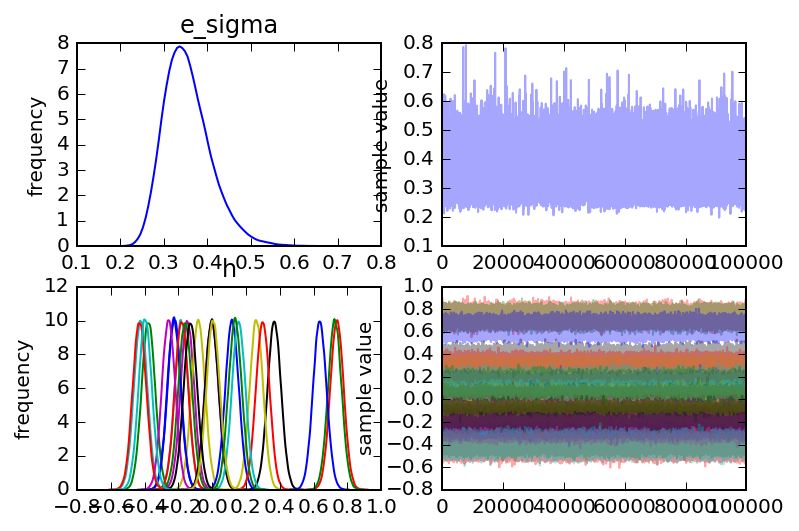

In [7]:
fig = fit.traceplot()

In [8]:
la = fit.extract(permuted=True)  # return a dictionary of arrays

a = fit.extract(permuted=False)

e_sigma = la['e_sigma'].reshape(4,-1)
print(e_sigma.shape)
#print(e_sigma.reshape(4,5000))

(4, 25000)


In [9]:
num_chains = 4

df = pd.DataFrame(la.items())
print(df)
#print(df.keys())

samples_Stan = dict(zip(df[0], df[1].values ))
#print(samples.items())
print(type(samples_Stan['e_sigma']))
print(samples_Stan.items())

#for j, i in samples_Stan.items():
#    print(j)
#    print(i.shape)

         0                                                  1
0  e_sigma  [0.450841139453, 0.396415916907, 0.37955172688...
1        h  [[-0.191905707766, -0.312612135404, 0.64260683...
2     lp__  [-48.7829623752, -49.2711871084, -52.171071949...
<type 'numpy.ndarray'>
[(u'h', array([[-0.19190571, -0.31261214,  0.64260683, ...,  0.20193255,
        -0.3839359 , -0.42359652],
       [-0.11832324, -0.32095844,  0.72337831, ...,  0.21006428,
        -0.41922925, -0.41598792],
       [-0.16780421, -0.36514553,  0.84053104, ...,  0.08724851,
        -0.50926322, -0.51244004],
       ..., 
       [-0.23166189, -0.39249998,  0.72802999, ...,  0.13995737,
        -0.37717786, -0.39662337],
       [-0.27149211, -0.49470886,  0.75455421, ...,  0.10418333,
        -0.49581629, -0.38421921],
       [-0.24871167, -0.34433998,  0.70293649, ...,  0.18271723,
        -0.484069  , -0.44899698]])), (u'lp__', array([-48.78296238, -49.27118711, -52.17107195, ..., -36.50935   ,
       -41.77472118, -46.27

In [10]:

## Print and check the shape of the resultant samples dictionary:
#print(samples)
#print(samples.items())
print('-----')
print(samples_Stan['e_sigma'].shape)
print(samples_Stan['h'].shape)
print(samples_Stan['h'][:,3].shape)
print('-----')


## Update the samples dictionary so that it includes keys for the latent variables
## Also, we will use LaTeX formatting to help make legible plots ahead.  
samples_Nm1_Stan = {}

## adjust the thin varible to only look at every #th population element 
thin1 = 1

## Need to enter the number of hyperparameter variables here:
numHyperParams = 1

## Specify the dimension we want for our plot below, for legibility.  
dim1 = (Ndata/thin1) + numHyperParams
print(dim1)

for i in np.arange(0,Ndata,thin1):
    samples_Nm1_Stan.update({'$h_{'+str(i+1)+'}$': samples_Stan['h'][:,i]})

## Add the hyperparameter marginal posterior back in:
samples_Nm1_Stan.update({'$e_{\sigma}$': samples_Stan['e_sigma']})
print(samples_Nm1_Stan['$h_{5}$'].shape)

## Reshape values for diagnostic plot functions (trace, autocorrelation) below:  
samples_Nm1_trace_Stan = {}    
for j, i in samples_Nm1_Stan.items():
    samples_Nm1_trace_Stan.update({str(j): i.reshape(int(len(i)/num_chains),-1)})




-----
(100000,)
(100000, 25)
(100000,)
-----
26.0
(100000,)


In [11]:
## equal tailed 95% credible intervals, and posterior distribution means:
def summary(samples, varname, p=95):
    values = samples[varname][0]
    ci = np.percentile(values, [100-p, p])
    print('{:<6} mean = {:>5.1f}, {}% credible interval [{:>4.1f} {:>4.1f}]'.format(
      varname, np.mean(values), p, *ci))

for varname in samples_Nm1_trace_Stan:
    summary(samples_Nm1_trace_Stan, varname)


$h_{2}$ mean =  -0.3, 95% credible interval [-0.4 -0.3]
$h_{21}$ mean =  -0.2, 95% credible interval [-0.2 -0.1]
$h_{12}$ mean =   0.0, 95% credible interval [ 0.0  0.1]
$h_{3}$ mean =   0.7, 95% credible interval [ 0.7  0.8]
$h_{14}$ mean =  -0.0, 95% credible interval [-0.0  0.0]
$h_{20}$ mean =   0.0, 95% credible interval [-0.0  0.0]
$h_{22}$ mean =   0.6, 95% credible interval [ 0.6  0.7]
$h_{15}$ mean =   0.1, 95% credible interval [ 0.1  0.2]
$h_{17}$ mean =   0.3, 95% credible interval [ 0.3  0.3]
$h_{5}$ mean =  -0.2, 95% credible interval [-0.2 -0.2]
$h_{13}$ mean =   0.3, 95% credible interval [ 0.2  0.3]
$h_{18}$ mean =   0.2, 95% credible interval [ 0.1  0.2]
$h_{9}$ mean =   0.7, 95% credible interval [ 0.7  0.7]
$h_{19}$ mean =  -0.3, 95% credible interval [-0.3 -0.2]
$e_{\sigma}$ mean =   0.4, 95% credible interval [ 0.3  0.4]
$h_{16}$ mean =  -0.2, 95% credible interval [-0.2 -0.1]
$h_{4}$ mean =  -0.1, 95% credible interval [-0.2 -0.1]
$h_{24}$ mean =  -0.4, 95% credi

Variable
$e_{\sigma}$    0.354564
$h_{10}$       -0.181082
$h_{11}$       -0.423152
$h_{12}$       -0.002835
$h_{13}$        0.261157
$h_{14}$       -0.002150
$h_{15}$        0.117845
$h_{16}$       -0.159989
$h_{17}$        0.298926
$h_{18}$        0.156928
$h_{19}$       -0.257865
$h_{1}$        -0.226043
$h_{20}$        0.005485
$h_{21}$       -0.128257
$h_{22}$        0.636386
$h_{23}$        0.135741
$h_{24}$       -0.429909
$h_{25}$       -0.396016
$h_{2}$        -0.377171
$h_{3}$         0.738000
$h_{4}$        -0.181300
$h_{5}$        -0.146461
$h_{6}$        -0.082021
$h_{7}$         0.367647
$h_{8}$        -0.224129
$h_{9}$         0.725575
dtype: float64
Variable  $e_{\sigma}$  $h_{10}$  $h_{11}$  $h_{12}$  $h_{13}$  $h_{14}$  \
0.05           0.27750 -0.246640 -0.488720 -0.067728  0.195970 -0.067258   
0.95           0.45308 -0.115748 -0.358291  0.062169  0.326038  0.063230   

Variable  $h_{15}$  $h_{16}$  $h_{17}$  $h_{18}$    ...     $h_{24}$  \
0.05      0.052523 -0.226

//anaconda/lib/python2.7/site-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


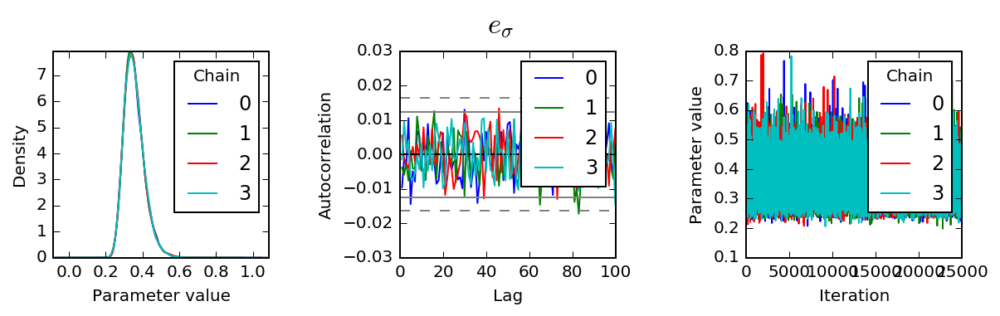

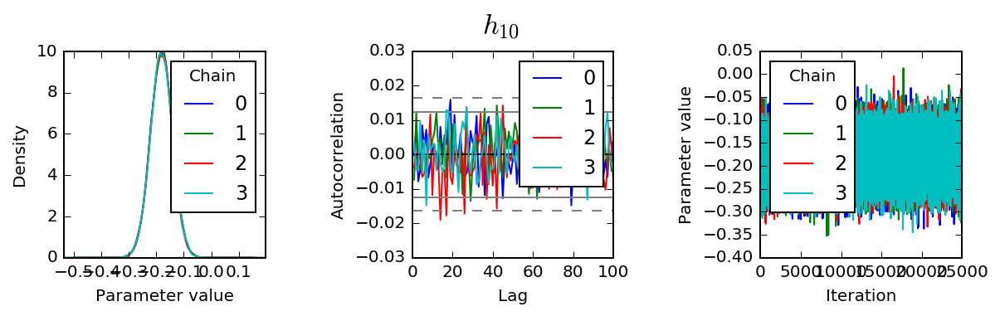

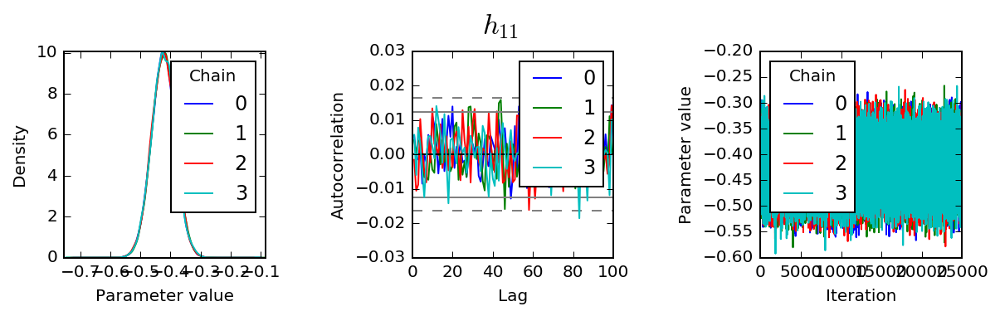

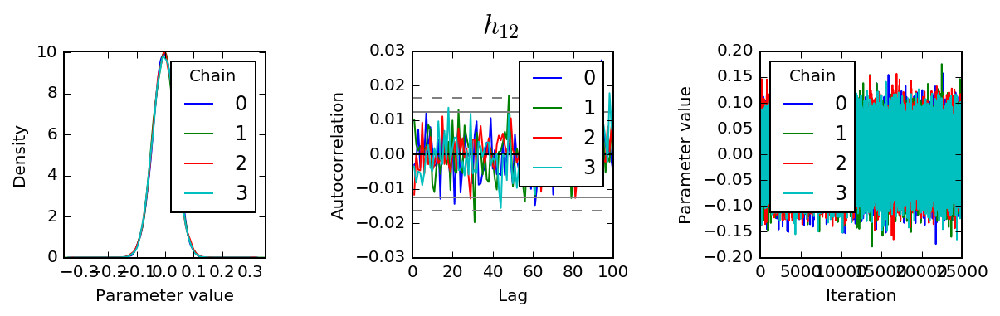

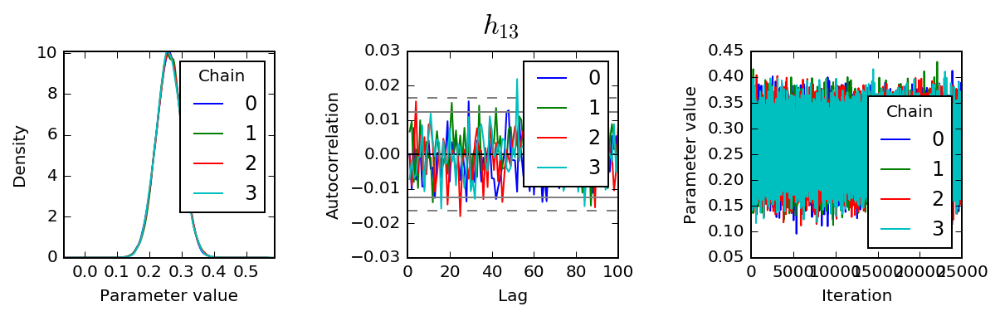

...

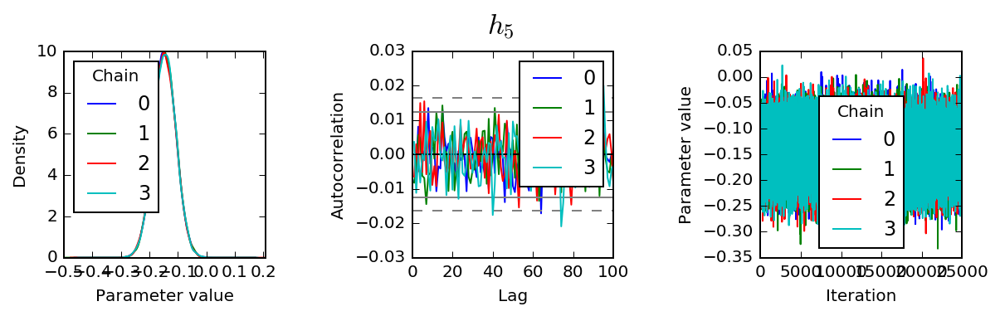

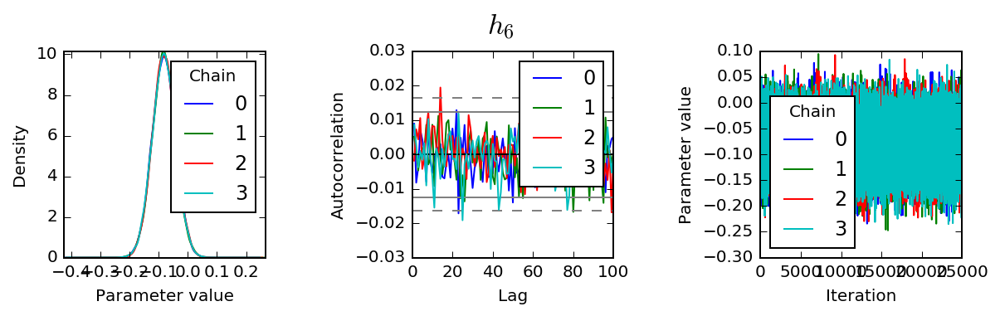

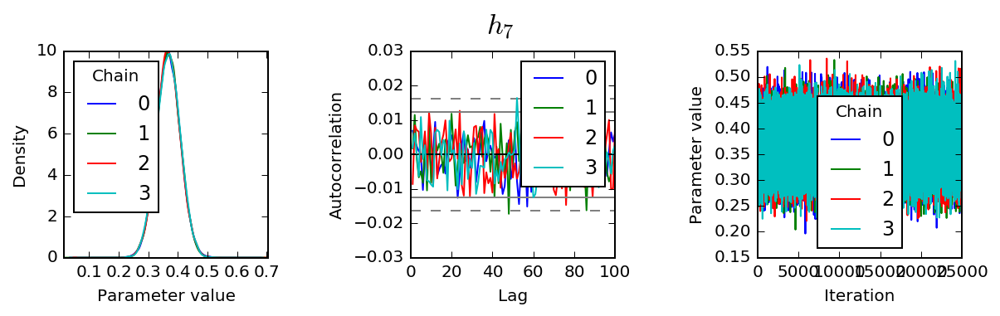

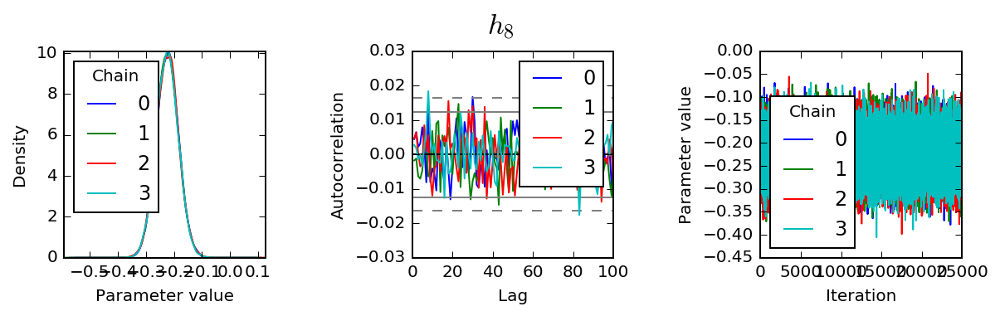

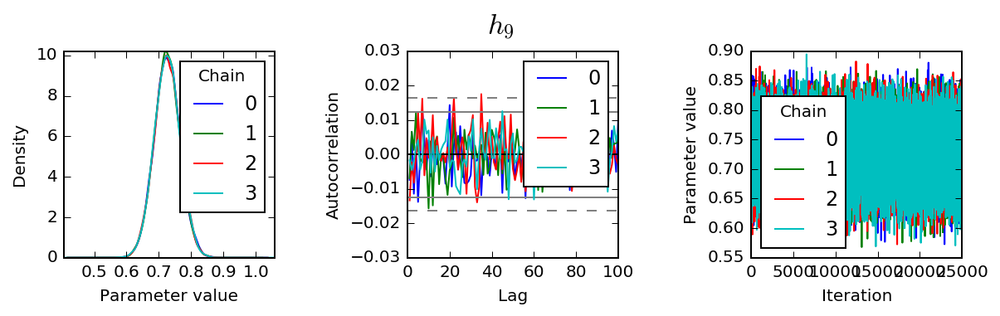

In [12]:
## Use pandas three dimensional Panel to represent the trace:

trace_1_Stan = pd.Panel({k: v for k, v in samples_Nm1_trace_Stan.items()})
trace_1_Stan.axes[0].name = 'Variable'
trace_1_Stan.axes[1].name = 'Iteration'
trace_1_Stan.axes[2].name = 'Chain'
 
## Point estimates:
print(trace_1_Stan.to_frame().mean())
 
## Bayesian equal-tailed 95% credible intervals:
print(trace_1_Stan.to_frame().quantile([0.05, 0.95]))
  ## ^ entering the values here could be a good question part
    
def plot(trace, var):
    fig, axes = plt.subplots(1, 3, figsize=(9, 3))
    fig.suptitle(var, y=0.95, fontsize='xx-large')
 
    ## Marginal posterior density estimate:
    trace[var].plot.density(ax=axes[0])
    axes[0].set_xlabel('Parameter value')
    axes[0].locator_params(tight=True)
 
    ## Autocorrelation for each chain:
    axes[1].set_xlim(0, 100)
    for chain in trace[var].columns:
        autocorrelation_plot(trace[var,:,chain], axes[1], label=chain)
 
    ## Trace plot:
    axes[2].set_ylabel('Parameter value')
    trace[var].plot(ax=axes[2])
 
    ## Save figure
    filename = var.replace("\\", "") 
    filename = filename.replace("$", "") 
    filename = filename.replace("}", "") 
    filename = filename.replace("{", "") 
    plt.tight_layout(pad=3)
    fig.savefig('/Users/meganshabram/Dropbox/NASA_Postdoctoral_Program_Fellowship/LSSTC DSFP Session 4 Workshop/Plots2/Nm1_Stan/Nm1_'+'{}.png'.format(filename))
 
# Display diagnostic plots
for var in trace_1_Stan:
    plot(trace_1_Stan, var)
 


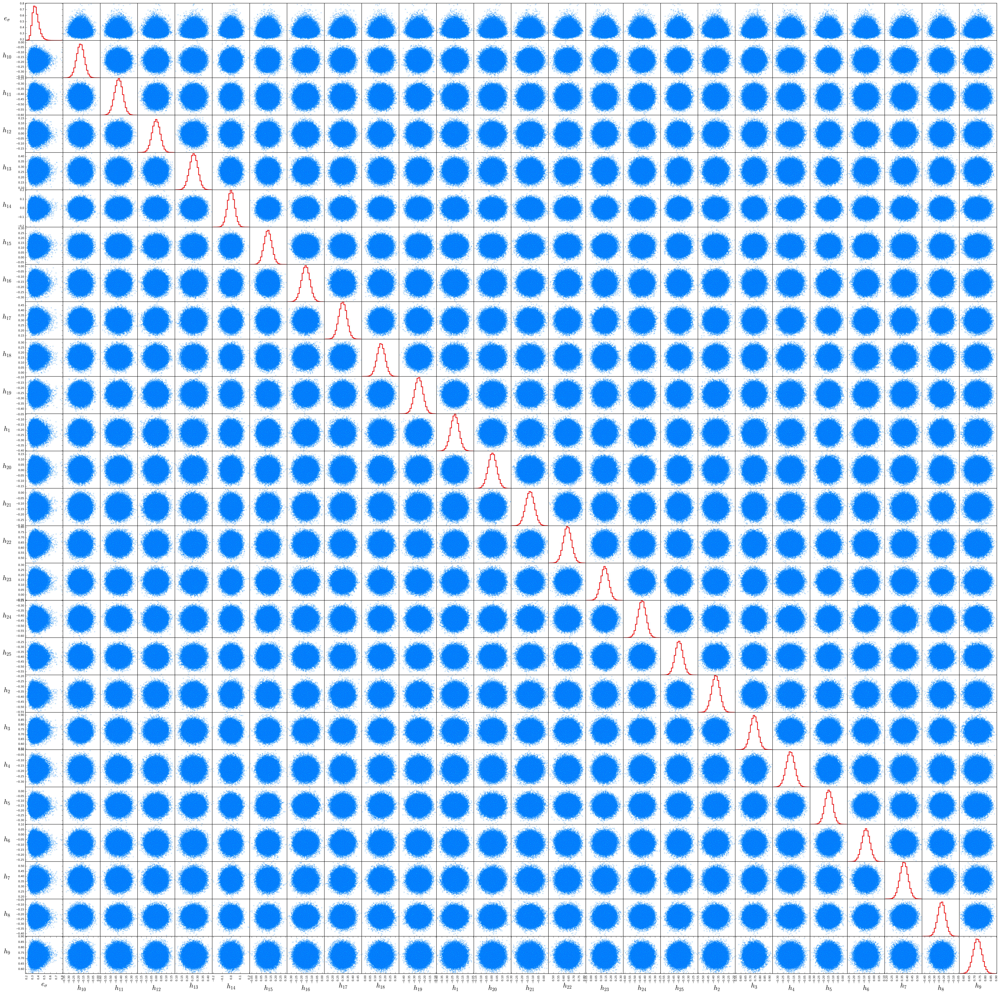

In [13]:
## Scatter matrix plot:
##    If Ndata is increase, this scatter_matrix might do better to skip every nth latent variable
##    Code for that is in a future code cell, where we make a triangle plot with KDE for 
##    joint 2D marginals. scatter_matrix is a Python Pandas module.

sm = scatter_matrix(trace_1_Stan.to_frame(),  color="#00BFFF", alpha=0.2, figsize=(dim1*2, dim1*2), diagonal='hist',hist_kwds={'bins':25,'histtype':'step', 'edgecolor':'r','linewidth':2})

## y labels size
[plt.setp(item.yaxis.get_label(), 'size', 20) for item in sm.ravel()]

## x labels size 
[plt.setp(item.xaxis.get_label(), 'size', 20) for item in sm.ravel()]

## Change label rotation.  This is helpful for very long labels
#[s.xaxis.label.set_rotation(45) for s in sm.reshape(-1)]

[s.xaxis.label.set_rotation(0) for s in sm.reshape(-1)]
[s.yaxis.label.set_rotation(0) for s in sm.reshape(-1)]

## May need to offset label when rotating to prevent overlap of figure
[s.get_yaxis().set_label_coords(-0.5,0.5) for s in sm.reshape(-1)]

## Hide all ticks
#[s.set_xticks(()) for s in sm.reshape(-1)]
#[s.set_yticks(()) for s in sm.reshape(-1)]

## Save the figure as .png 
plt.savefig('/Users/meganshabram/Dropbox/NASA_Postdoctoral_Program_Fellowship/LSSTC DSFP Session 4 Workshop/Plots2/scatter_matrix_Nm1_Stan.png')


In [14]:

## Redefine the trace so that we only vizualize every #th latent variable element in 
## the scatter_matrix plot below. Vizualizing all Ndata is too cumbersome for the scatter
## matrix. 

## adjust the thin varible to only look at every #th population element 
##Ndata is 25 use 
thin = 5
##Ndata is 20 use
#thin = 4

## Re-specify the dimension we want for our plot below, with thinning, for legibility.  
dim2 = (Ndata/thin) + numHyperParams
print(dim2)

samples_Nm1_triangle_1_Stan = {}
truths_hhat = {}
truths_h = {}
for i in np.arange(0,Ndata,thin):
    samples_Nm1_triangle_1_Stan.update({'$h_{'+str(i+1)+'}$': samples_Stan['h'][:,i]})
    truths_hhat.update({'$h_{'+str(i+1)+'}$': hhat[i]})
    truths_h.update({'$h_{'+str(i+1)+'}$': h[i]})
samples_Nm1_triangle_1_Stan.update({'$e_{\sigma}$': samples_Stan['e_sigma']})
truths_hhat.update({'$e_{\sigma}$': sigmae})
truths_h.update({'$e_{\sigma}$': sigmae})

## Reshape values for diagnostic plot functions (trace, autocorrelation, scatter_matrix):  
#samples_Nm1_triangle_trace_Stan = {}    
#for j, i in samples_Nm1_triangle_Stan.items():
#    samples_Nm1_triangle_trace_Stan.update({str(j): i.reshape(int(len(i)/num_chains),-1)})
#
#print(list(samples_Nm1_scatter_matrix_trace.items()))
#print(list(samples_Nm1_scatter_matrix_trace['$h_{6}$'][0]))



6.0


In [15]:
#trace_2.to_frame()
print(samples_Nm1_triangle_1_Stan.keys())
print(5000*num_chains)
print(int(dim2))
print(truths_hhat.values())

['$h_{16}$', '$h_{21}$', '$h_{6}$', '$e_{\\sigma}$', '$h_{1}$', '$h_{11}$']
20000
6
[-0.16209109294213217, -0.1300982270632908, -0.083107066294106524, 0.3, -0.22918490480872103, -0.42884625267180465]


(100000, 6)


//anaconda/lib/python2.7/site-packages/numpy/ma/core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.maximum.reduce will be axis=0, not the current None, to match np.maximum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)
//anaconda/lib/python2.7/site-packages/numpy/ma/core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.minimum.reduce will be axis=0, not the current None, to match np.minimum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)


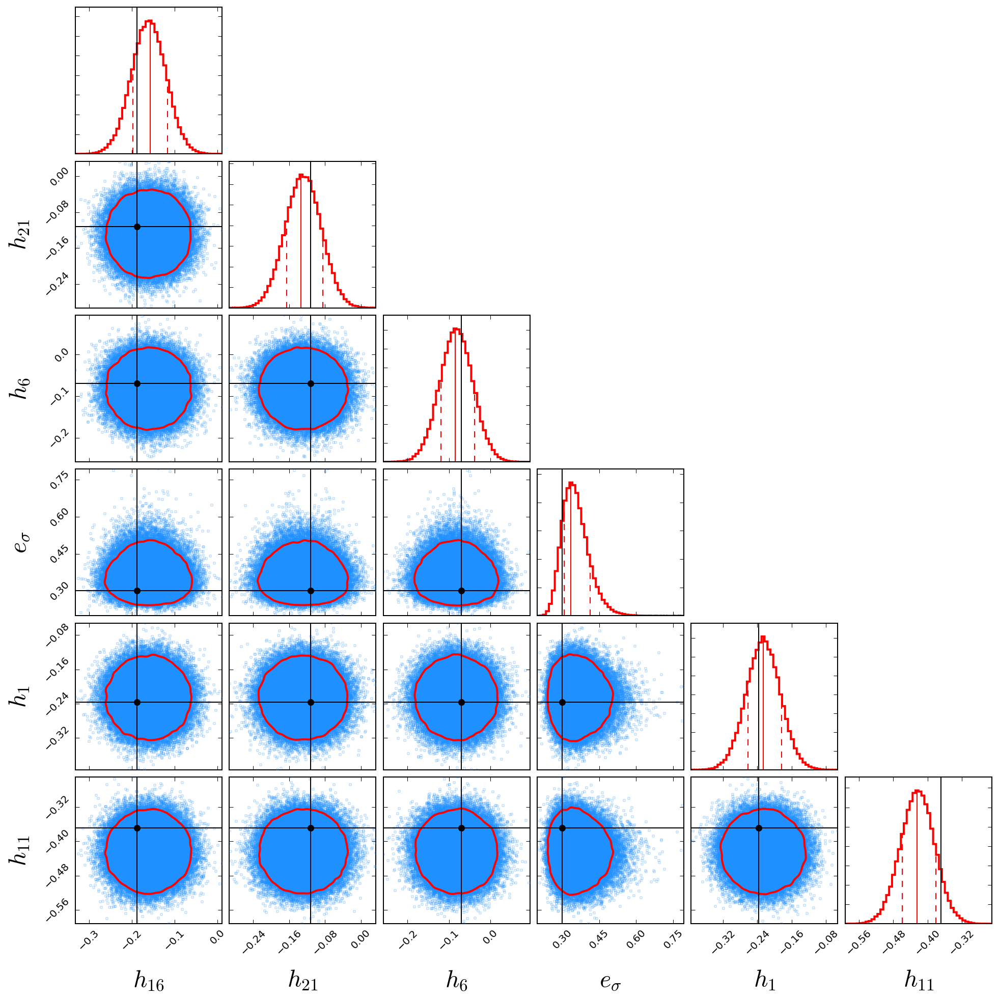

In [16]:

#data = np.asarray(samples_Nm1_scatter_matrix_triangle.values()).reshape((5000*num_chains),int(dim2))
#print(np.asarray(samples_Nm1_scatter_matrix_triangle.values()).reshape((5000*num_chains),int(dim2)).shape)

samples_Nm1_triangle_2_Stan = {}    
for j, i in samples_Nm1_triangle_1_Stan.items():
    samples_Nm1_triangle_2_Stan.update({str(j): i.reshape(-1,1)})
    
data = None
for k, v in samples_Nm1_triangle_2_Stan.items():
    column = v.reshape(-1,1)
    if data is None:
        data = column
    else:
        data = np.hstack((data, column))

print(data.shape)

figure = triangle_linear.corner(data,labels=samples_Nm1_triangle_2_Stan.keys(),labelsy=samples_Nm1_triangle_2_Stan.keys(), truths=truths_h.values(), truths_color = 'black')

plt.savefig('/Users/meganshabram/Dropbox/NASA_Postdoctoral_Program_Fellowship/LSSTC DSFP Session 4 Workshop/Plots2/triangle_linear_Nm1_Stan.png')


In [17]:
display(Math(r'\sqrt{a^2 + b^2}')) 

print(h[1])

<IPython.core.display.Math object>

-0.3888086651


$$c = \sqrt{a^2 + b^2}$$


Overplot the true value and the measurement uncertainy with the marginal posterior.

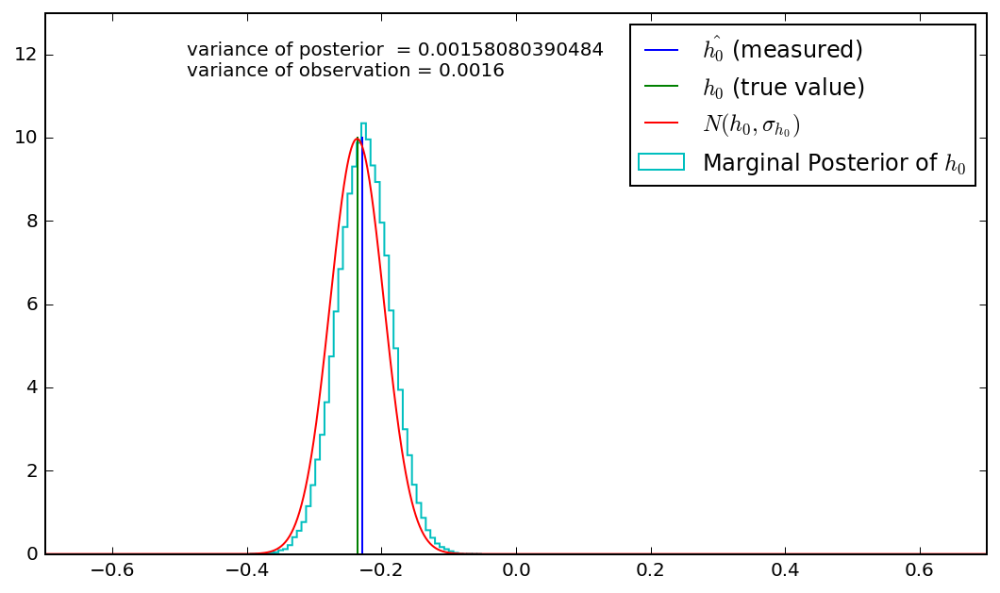

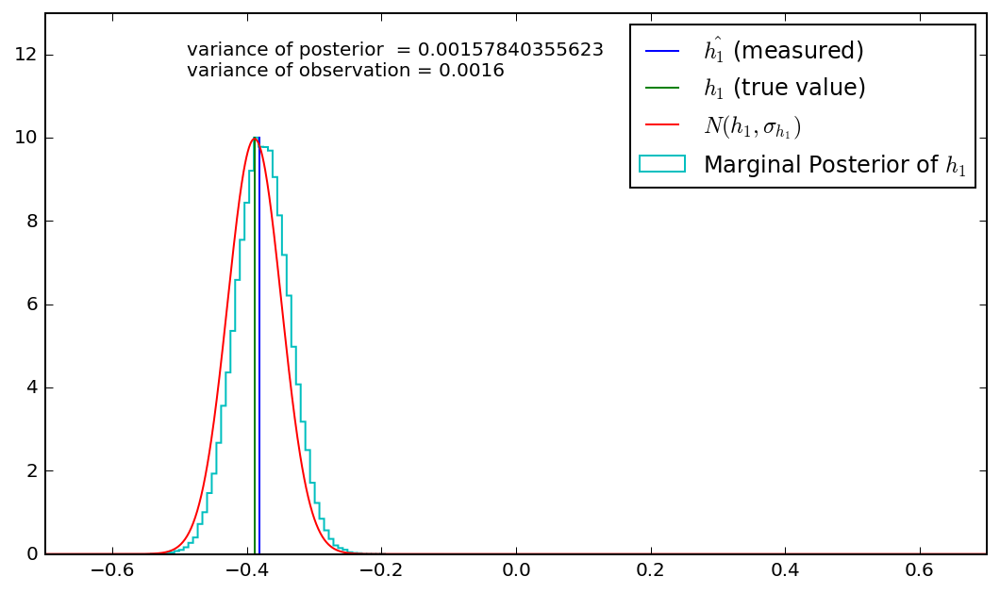

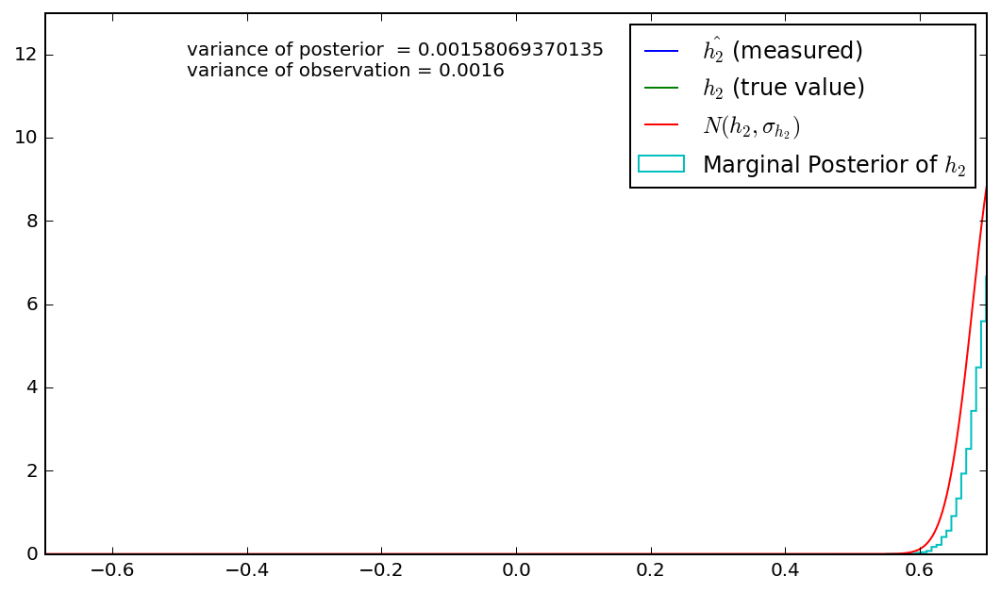

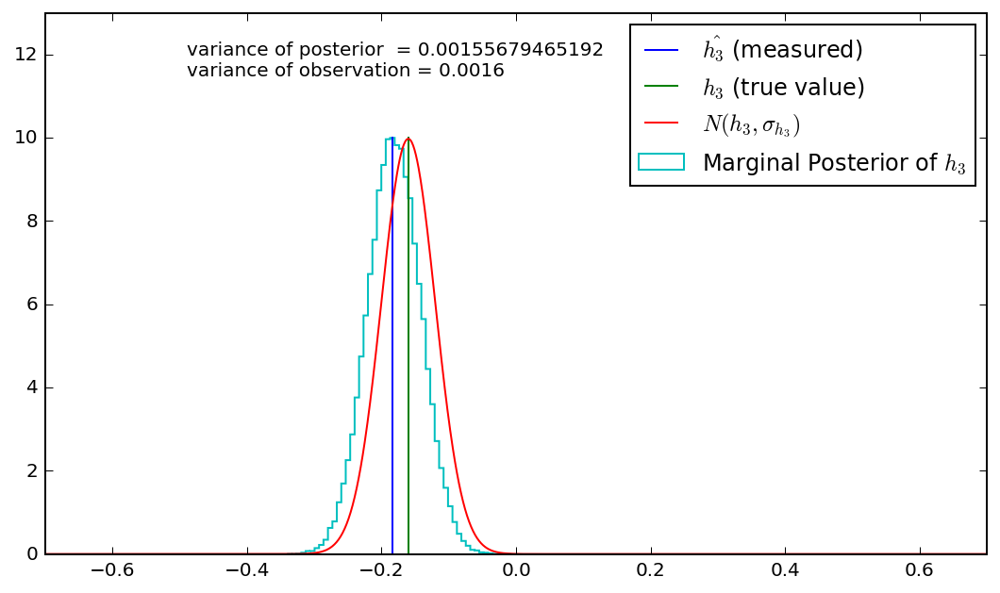

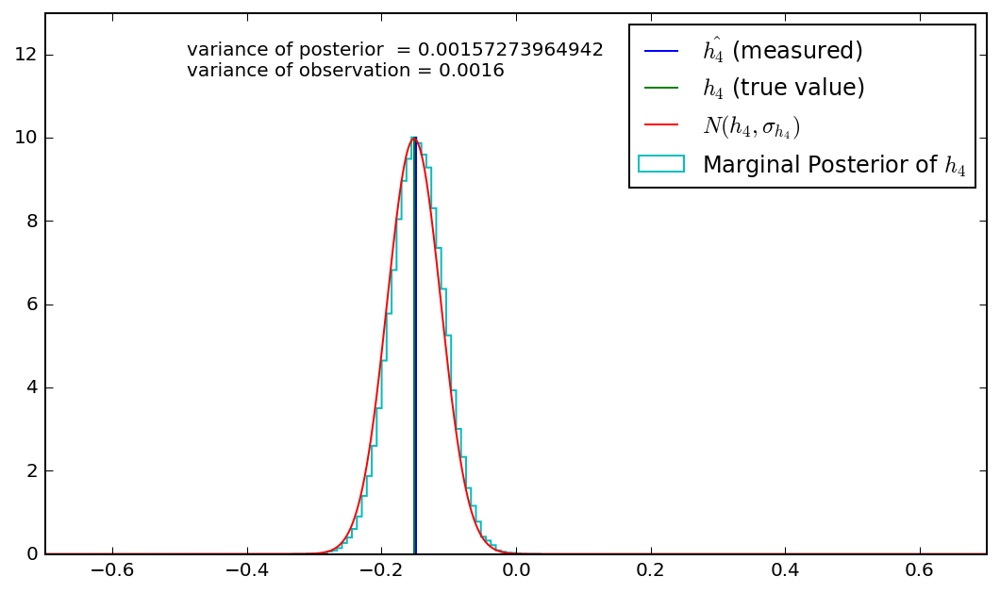

...

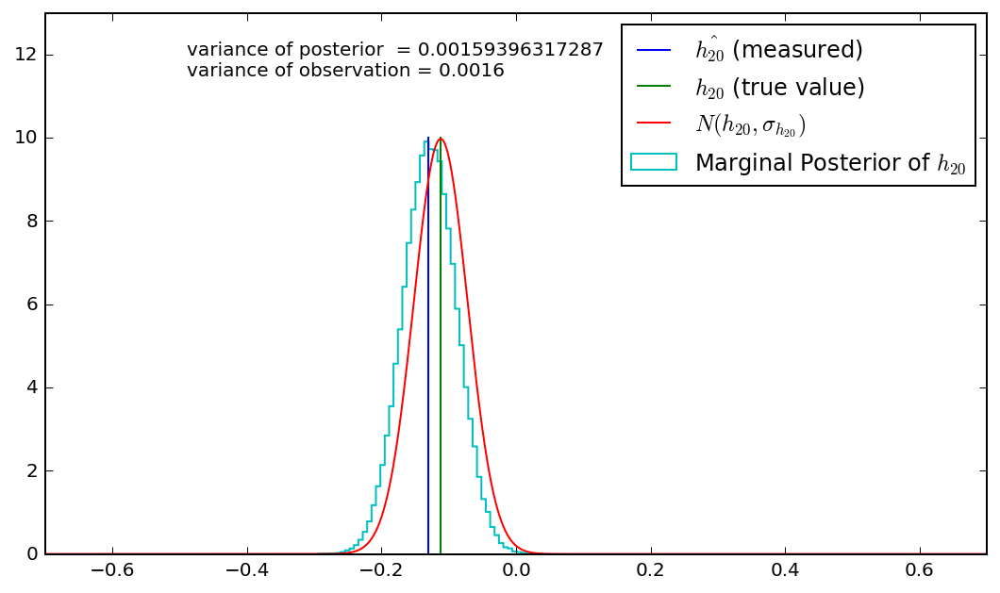

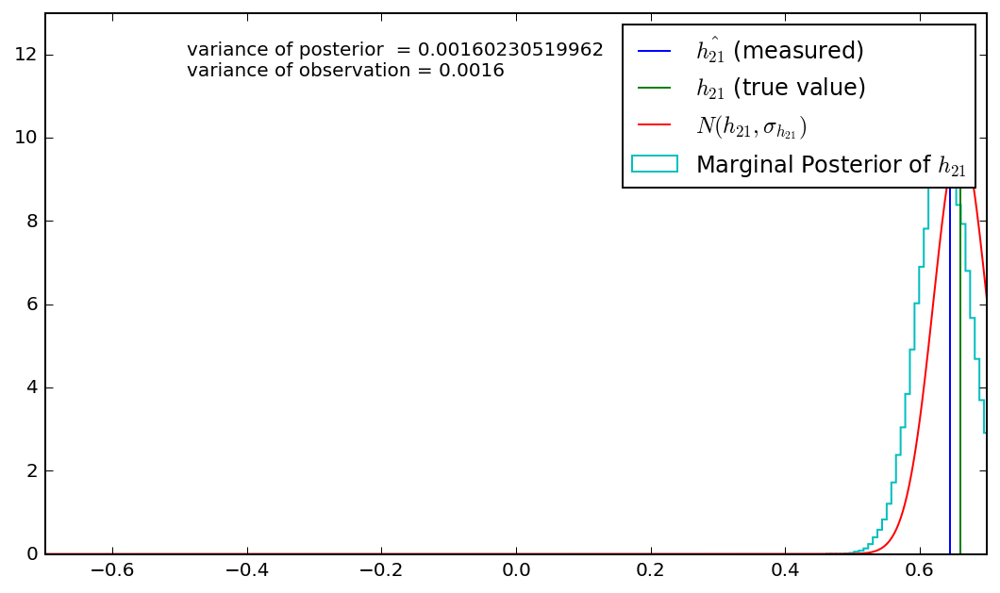

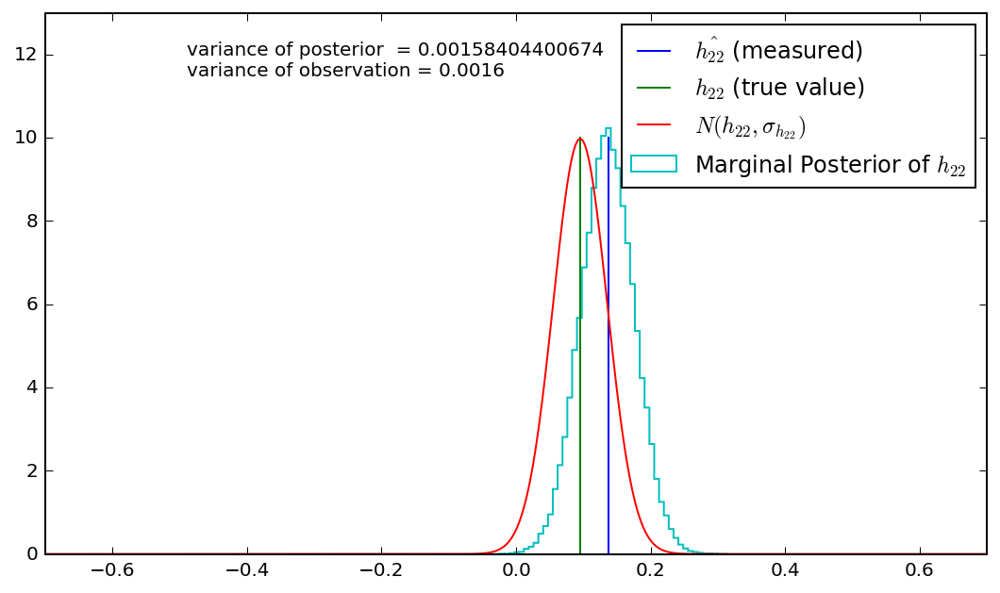

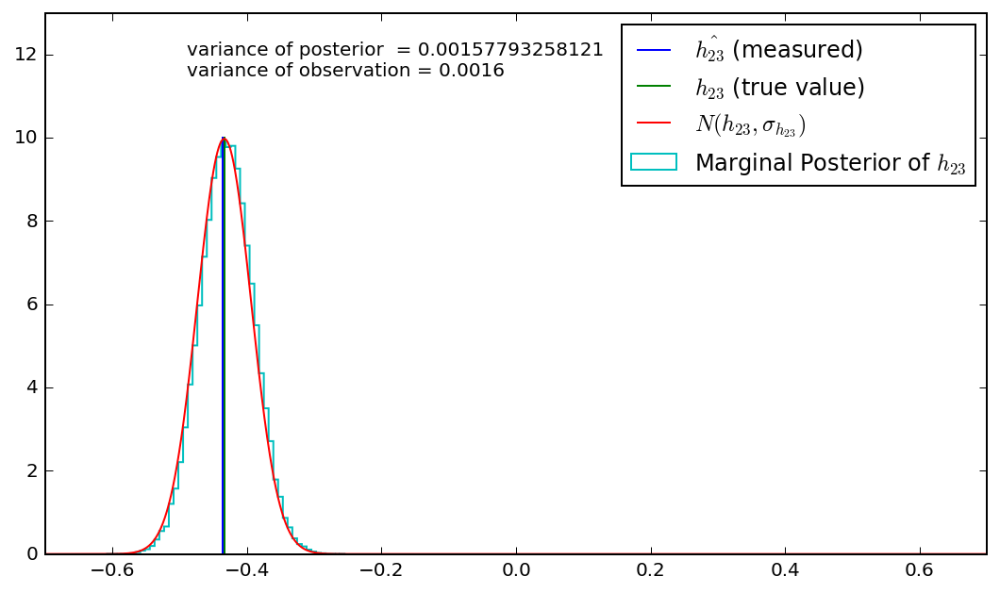

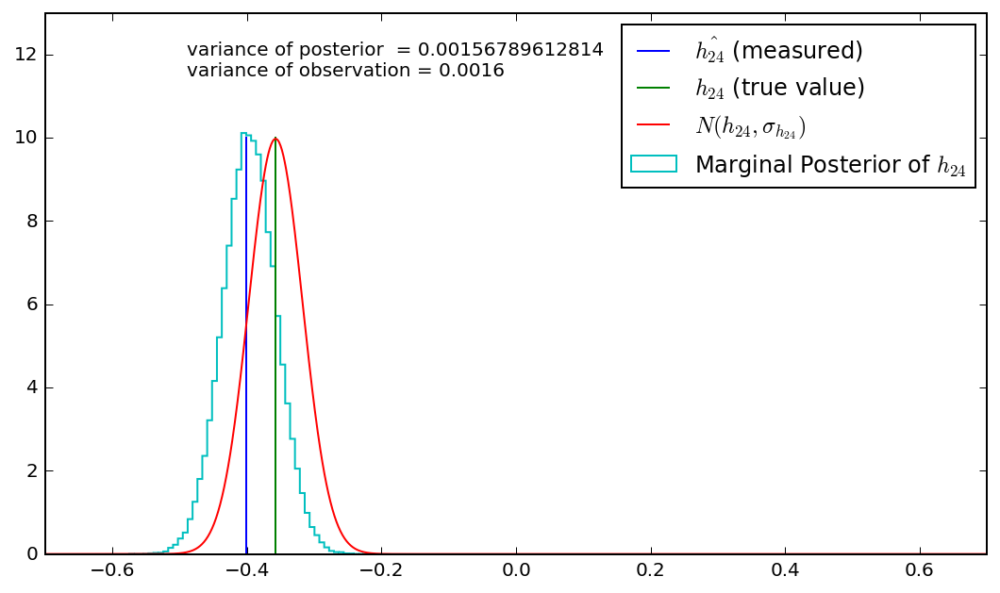

In [18]:
def plot_2(Ndata):
    for i in np.arange(0,Ndata):
        fig = plt.figure(figsize=(8,5))
        x = np.arange(-1,1, 0.001)
        fit = stats.norm.pdf(x, h[i], sigmahobs) 
        plt.plot([hhat[i],hhat[i]], [0,10],label=r'$\hat{h_{'+str(i)+'}}$ (measured)')
        plt.plot([h[i],h[i]], [0,10],label=r'$h_{'+str(i)+'}$ (true value)')
        plt.plot(x,fit,'-',label=r'$N(h_{'+str(i)+'},\sigma_{h_{'+str(i)+'}})$')
        plt.hist(samples_Stan['h'][:,i],histtype='step', bins=50, normed=True,label=r'Marginal Posterior of $h_{'+str(i)+'}$')
        plt.xlim(-0.7,0.7)
        plt.ylim(0,13)
        plt.legend()
        plt.text(-.49, 12,'variance of posterior  = '+str(np.var(samples_Stan['h'][:,i])))
        plt.text(-.49, 11.5,'variance of observation = '+str(sigmahobs**2))
        plt.tight_layout(pad=3)
        fig.savefig('/Users/meganshabram/Dropbox/NASA_Postdoctoral_Program_Fellowship/LSSTC DSFP Session 4 Workshop/Plots2/Nm1_Stan/Nm1_latent_var_h'+str(i)+'.png')

plot_2(Ndata)        

[Wikipedia article for credible interval](https://en.wikipedia.org/wiki/Credible_interval)
"Choosing the interval where the probability of being below the interval is as likely as being above it. This interval will include the median. This is sometimes called the equal-tailed interval."

TO DO
    - [DONE!] get dataframe working properly, try pandas?
    - [DONE!]look at output more, explore shrinkage? 
    - [Done!] plot truths in scatter plot? plot truths on histograms 
    - [Done!] separete missing autocorrelation plots here. 
    - [Done!] Truths, h or hhat?
    
    - Add JAGS code
    - explore draws from the posterior plotted as normals on top of data
    - explore an NM2 model in the framework on an Nm1 analysis
    - What happens when you inrease the fractional uncertainty?, what may solve this?
    - What happens if there is missing data?
    - third notebook with breakpoint model? eclipsing binary data that is real? (dont save posteriors for each latent value here).  

In [19]:


##Missing values possible with JAGS:
df = pd.DataFrame(hhat)
print(df)
replaced = collections.defaultdict(set)
ix = [(row, col) for row in range(df.shape[0]) for col in range(df.shape[1])]
random.shuffle(ix)
to_replace = int(round(.1*len(ix)))
for row, col in ix:
    if len(replaced[row]) < df.shape[1] - 1:
        df.iloc[row, col] = np.nan
        to_replace -= 1
        replaced[row].add(col)
        if to_replace == 0:
            break

           0
0  -0.229185
1  -0.382081
2   0.747925
3  -0.183720
4  -0.148403
5  -0.083107
6   0.372677
7  -0.227081
8   0.735411
9  -0.183523
10 -0.428846
11 -0.002957
12  0.264689
13 -0.002045
14  0.119470
15 -0.162091
16  0.302870
17  0.158961
18 -0.261297
19  0.005497
20 -0.130098
21  0.644889
22  0.137832
23 -0.435826
24 -0.401360


NameError: name 'collections' is not defined